# **Importing the Required Libraries**

In [1]:
import os
import glob
from IPython.display import Image, display


# **In the First Step, We need to check whether we have access to the GPU or not**

In [2]:
!nvidia-smi

Mon Sep 25 10:24:21 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 3060        On  | 00000000:09:00.0  On |                  N/A |
|  0%   48C    P5              19W / 170W |    564MiB / 12288MiB |     35%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [5]:
HOME = f'{os.getcwd()}/content'

In [6]:
print(HOME)

/home/fabio/Documents/Github/Yolov8/Aula_5/content


# **Installing Ultralytics using Pip Install**

In [4]:
!pip install ultralytics==8.0.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 219.8/219.8 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.5/189.5 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 7.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=41485b7974bea823583b3ba38b9910241a0876ab4dd4ea166e6858b44abcf7c3
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime


In [8]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.170 🚀 Python-3.9.18 torch-2.0.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)
Setup complete ✅ (8 CPUs, 23.4 GB RAM, 3.4/29.8 GB disk)


In [9]:
!mkdir {HOME}/datasets

In [10]:
%cd {HOME}/datasets

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets


# **Importing the Helmets Segmentation Dataset from Roboflow**

In [11]:
%cd {HOME}/datasets
!pwd

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets
/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets


In [12]:
#https://universe.roboflow.com/celebal/helmet-mvi3d
# !pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="zI9OTjbwPrkuQDUQXD8i")
project = rf.workspace("celebal").project("helmet-mvi3d")
dataset = project.version(2).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.134 is required but found version=8.0.170, to fix: `pip install ultralytics==8.0.134`


Extracting Dataset Version Zip to Helmet-2 in yolov8:: 100%|██████████| 601/601 [00:00<00:00, 4407.88it/s]


# **Train the YOLOv8 Model on the Custom Dataset**

In [13]:
%cd {HOME}

/home/fabio/Documents/Github/Yolov8/Aula_5/content


In [18]:
dataset.location  = f'{HOME}/datasets/Helmet-2'

In [19]:
%cd {dataset.location}

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2


In [20]:
data= f'{HOME}/datasets/Helmet-2/data.yaml'

In [ ]:
from ultralytics import YOLO





# Load a COCO-pretrained YOLOv8n model
#model = YOLO('yolov8n-seg.pt')

# Display model information (optional)
#model.info()

# Train the model on the COCO8 example dataset for 100 epochs
#results = model.train(data='/content/datasets/Helmet-2/data.yaml', epochs=80, imgsz=640)


#!yolo task=detect mode=train model=yolov8m.pt data=/content/datasets/potholes-detection-yolonas-5/data.yaml epochs=70 imgsz=640
!yolo task=segment mode=train model=yolov8n-seg.pt data={dataset.location}/data.yaml   epochs=80 imgsz=640



New https://pypi.org/project/ultralytics/8.0.186 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.170 🚀 Python-3.9.18 torch-2.0.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/data.yaml, epochs=80, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, s

In [33]:
HOME = f'{os.getcwd()}'
print(HOME)
!ls {HOME}/runs/segment/train

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2
args.yaml  weights


# **Training and Validation Loss**

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2


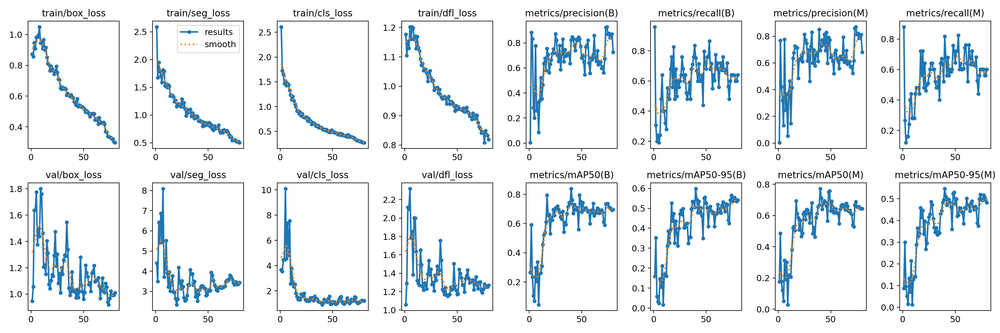

In [36]:
# Here is the graph of the training and validation loss
#box loss and class loss is important
# The behavior of the model is convincing the model is coverging, Training more will give better results
%cd {HOME}

Image(filename=f'{HOME}/runs/segment/train3/results.png', width=600)

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2


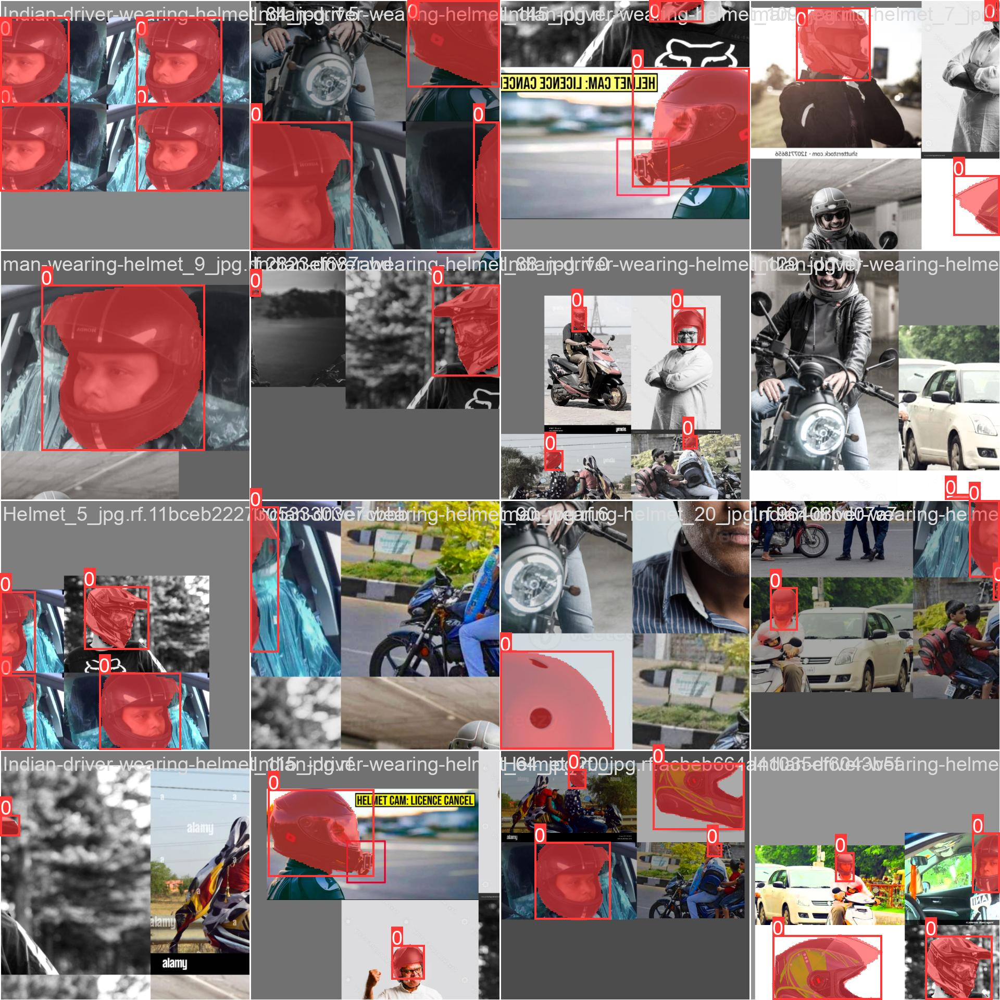

In [40]:
#Model Prediction on validation batch. These image are not used strictly for training so it is always better to take a
#look and see how model is behaving
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train3/train_batch0.jpg', width=600)

# **Validate Custom Model**

In [41]:
#Here, we are taking the model best weights and using them to validate the model

%cd {HOME}

#!python val.py model='{HOME}/runs/segment/train2/weights/best.pt' data={dataset.location}/data.yaml
!yolo task=segment mode=val model='{HOME}/runs/segment/train2/weights/best.pt' data={dataset.location}/data.yaml

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2


Ultralytics YOLOv8.0.170 🚀 Python-3.9.18 torch-2.0.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)
YOLOv8n-seg summary (fused): 195 layers, 3258259 parameters, 0 gradients
val: Scanning /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all         24         25      0.723       0.84      0.783      0.542      0.663        0.8      0.712      0.524
Speed: 2.7ms preprocess, 40.9ms inference, 0.0ms loss, 7.4ms postprocess per image
Results saved to runs/segment/val


# **Displaying the Confusion Matrix**

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2


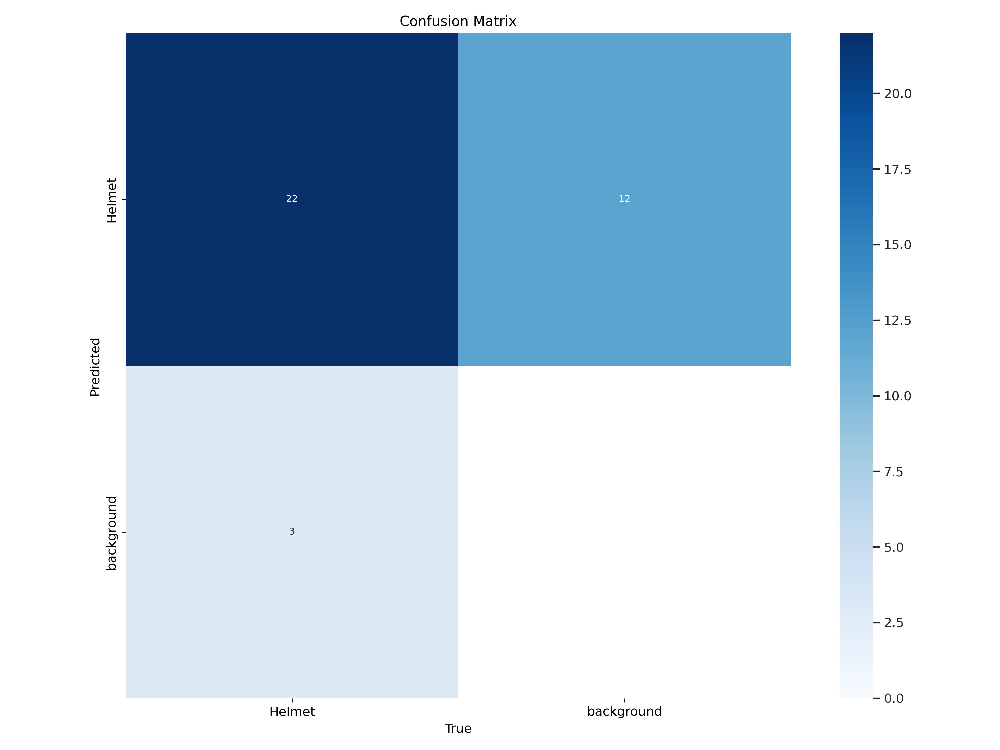

In [42]:
#Confusion matrix is the chart that shows how our model handles different classes
#92% of the time the model detected correctly that the person is wearing the helmet,  while 1% of the time when the person is wearing the helmet
#the model is unable to detect it
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/val/confusion_matrix.png', width=900)

# **Testing on a Demo Video**

In [43]:
!gdown "https://drive.google.com/uc?id=11frm2lKu_Rd4XNZ3dyynCSjMymN66_I8&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=11frm2lKu_Rd4XNZ3dyynCSjMymN66_I8&confirm=t
To: /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4
100%|██████████████████████████████████████| 10.1M/10.1M [00:00<00:00, 10.4MB/s]


In [44]:
!pwd

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2


In [56]:
%cd {HOME}

#!python predict.py model='{HOME}/runs/segment/train2/weights/best.pt' source='demo1.mp4'
!yolo task=segment mode=predict model='{HOME}/runs/segment/train3/weights/best.pt' conf=0.15 source='{HOME}/demo1.mp4'

/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2
Ultralytics YOLOv8.0.170 🚀 Python-3.9.18 torch-2.0.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)
YOLOv8n-seg summary (fused): 195 layers, 3258259 parameters, 0 gradients

video 1/1 (1/462) /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4: 384x640 (no detections), 196.2ms
video 1/1 (2/462) /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4: 384x640 1 Helmet, 8.1ms
video 1/1 (3/462) /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4: 384x640 (no detections), 8.3ms
video 1/1 (4/462) /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4: 384x640 (no detections), 8.5ms
video 1/1 (5/462) /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4: 384x640 (no detections), 9.7ms
video 1/1 (6/462) /home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4: 384x640 (no detec

# **Display the Demo Video**

In [1]:
!rm "content/result_compressed.mp4"

In [2]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4'

# Compressed video path
compressed_path = "/home/fabio/Documents/Github/Yolov8/Aula_5/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

# **Downloading the Demo Video2**

In [3]:
!gdown "https://drive.google.com/uc?id=1Q2tEqmTACa84EXGIiJitrCkoI_VlzjMH&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1Q2tEqmTACa84EXGIiJitrCkoI_VlzjMH&confirm=t
To: /home/fabio/Documents/Github/Yolov8/Aula_5/newbike.mp4
100%|██████████████████████████████████████| 50.5M/50.5M [00:04<00:00, 10.7MB/s]


# **Testing on the Demo Video**

In [9]:
%cd {HOME}
!yolo task=segment mode=predict model='/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/runs/segment/train3/weights/best.pt' conf=0.25 source='{HOME}/datasets/Helmet-2/newbike.mp4'
#!python predict.py model='{HOME}/runs/segment/train2/weights/best.pt' source='/content/datasets/Helmet-2/newbike.mp4'

/home/fabio/Documents/Github/Yolov8/Aula_5/content
Ultralytics YOLOv8.0.170 🚀 Python-3.9.18 torch-2.0.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060, 12042MiB)
YOLOv8n-seg summary (fused): 195 layers, 3258259 parameters, 0 gradients

Traceback (most recent call last):
  File "/home/fabio/mambaforge/envs/yolo/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
  File "/home/fabio/mambaforge/envs/yolo/lib/python3.9/site-packages/ultralytics/cfg/__init__.py", line 446, in entrypoint
    getattr(model, mode)(**overrides)  # default args from model
  File "/home/fabio/mambaforge/envs/yolo/lib/python3.9/site-packages/torch/utils/_contextlib.py", line 115, in decorate_context
    return func(*args, **kwargs)
  File "/home/fabio/mambaforge/envs/yolo/lib/python3.9/site-packages/ultralytics/engine/model.py", line 238, in predict
    return self.predictor.predict_cli(source=source) if is_cli else self.predictor(source=source, stream=stream)
  File "/home/fabio/mambaforge/envs/yolo/lib/python3.9/si

# **Display the Demo Video**

In [ ]:
!rm "/content/result2_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os


# Input video path
save_path = '/home/fabio/Documents/Github/Yolov8/Aula_5/content/datasets/Helmet-2/demo1.mp4'

# Compressed video path
compressed_path = "/home/fabio/Documents/Github/Yolov8/Aula_5/content/result2_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

# **Downloading the Demo Video3**

In [ ]:
!gdown "https://drive.google.com/uc?id=1GmMs8uNLBRyY-TsViLyjNs3M2ut8I0ej&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1GmMs8uNLBRyY-TsViLyjNs3M2ut8I0ej&confirm=t
To: /content/datasets/Helmet-2/bike2.mp4
100% 5.46M/5.46M [00:00<00:00, 41.6MB/s]


#**Testing on the Demo Video**

In [ ]:
%cd {HOME}
!yolo task=segment mode=predict model='{HOME}/runs/segment/train2/weights/best.pt' conf=0.25 source='/content/datasets/Helmet-2/bike2.mp4'




/content/datasets/Helmet-2
2023-09-12 02:40:37.948949: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-12 02:40:39.078249: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Fusing layers... 
YOLOv8n-seg summary: 195 layers, 3258259 parameters, 0 gradients, 12.0 GFLOPs
video 1/1 (1/266) /content/datasets/Helmet-2/bike2.mp4: 384x640 74.4ms
video 1/1 (2/266) /content/datasets/Helmet-2/bike2.mp4: 384x640 11.7ms
video 1/1 (3/266) /content/datasets/Helmet-2/bike2.mp4: 384x640 15.1ms
video 1/1 (4/266) /content/datasets/Helmet-2/bike2.mp4: 384x640 11.4ms
video 1/1 (5/266) /content/datasets/Helmet-2/bike2.mp4: 384x640 10.9ms


# **Display the Demo Video**

In [ ]:
!rm "/content/result_compressed.mp4"

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/datasets/Helmet-2/runs/segment/predict3/bike2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)